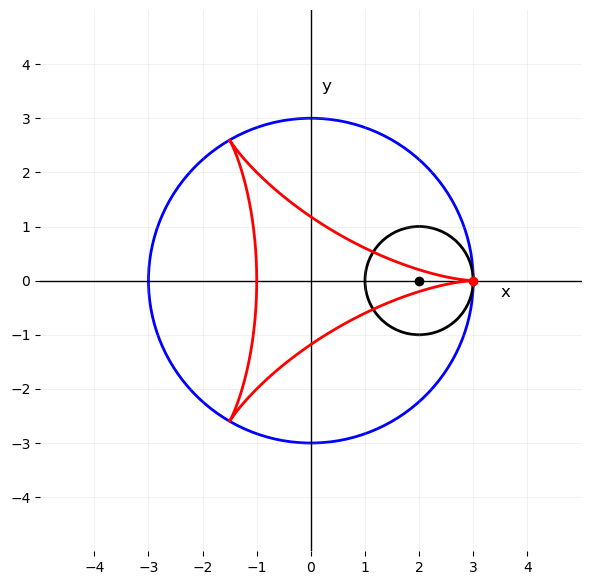

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Circle

def plot_epicycloid(R=3.0, r=1.0, points=2000, save_path=None, show=True):
    """
    Plot the epicycloid generated by a circle of radius r rolling
    around a fixed circle of radius R.

    Parameters
    ----------
    R : float
        Radius of the fixed circle.
    r : float
        Radius of the rolling circle.
    points : int
        Number of sample points for the epicycloid.
    save_path : str or None
        If provided, saves the figure to this path.
    show : bool
        If True, displays the figure. If False, closes it.
    
    Returns
    -------
    fig, ax : Matplotlib figure and axes objects
    """
    k = -(R - r) / r
    theta = np.linspace(0, 2*np.pi, points)
    x = (R - r) * np.cos(theta) + r * np.cos(k * theta)
    y = (R - r) * np.sin(theta) + r * np.sin(k * theta)

    fig, ax = plt.subplots(figsize=(6,6))

    # Grid
    ax.set_xlim(-R-r-1, R+r+1)
    ax.set_ylim(-R-r-1, R+r+1)
    ax.set_aspect('equal', 'box')
    ax.set_xticks(np.arange(-R-r, R+r+1, 1))
    ax.set_yticks(np.arange(-R-r, R+r+1, 1))
    ax.grid(True, which='both', linestyle='-', linewidth=0.5, alpha=0.25)

    # Axes lines
    ax.axhline(0, color='k', linewidth=1)
    ax.axvline(0, color='k', linewidth=1)
    ax.text(R+r-0.5, -0.3, 'x', fontsize=12)
    ax.text(0.2, R+r-0.5, 'y', fontsize=12)

    # Fixed circle (blue)
    ax.add_patch(Circle((0,0), R, fill=False, edgecolor='blue', linewidth=2))

    # Rolling circle (black) at initial position
    rolling_center = (R - r, 0.0)
    ax.add_patch(Circle(rolling_center, r, fill=False, edgecolor='black', linewidth=2))

    # Center dot
    ax.plot(rolling_center[0], rolling_center[1], 'ko')

    # Epicycloid path
    ax.plot(x, y, color='red', linewidth=2)

    # Starting point
    ax.plot([R], [0], 'o', color='red')

    # Clean frame
    for spine in ax.spines.values():
        spine.set_visible(False)

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')

    if not show:
        plt.close(fig)

    return fig, ax

fig, ax = plot_epicycloid(R=3.0, r=1.0, save_path="fig7.png")

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from matplotlib.animation import FuncAnimation
from matplotlib import rc

rc("animation", html="jshtml")   # for Jupyter animation display

def animate_epicycloid(R=3.0, r=1.0, frames=600, interval=20):
    """
    Animate the epicycloid generated by a circle of radius r rolling
    around a fixed circle of radius R.

    Parameters
    ----------
    R : float
        Radius of the fixed circle.
    r : float
        Radius of the rolling circle.
    frames : int
        Number of frames in the animation.
    interval : int
        Delay between frames in milliseconds.

    Returns
    -------
    ani : matplotlib.animation.FuncAnimation
        Animation object (renders inline in Jupyter).
    """
    k = - (R - r) / r
    theta = np.linspace(0, 2*np.pi, frames)
    x = (R - r) * np.cos(theta) + r * np.cos(k * theta)
    y = (R - r) * np.sin(theta) + r * np.sin(k * theta)

    fig, ax = plt.subplots(figsize=(6,6))
    ax.set_xlim(-R-r-1, R+r+1)
    ax.set_ylim(-R-r-1, R+r+1)
    ax.set_aspect('equal', 'box')
    ax.set_xticks(np.arange(-R-r, R+r+1, 1))
    ax.set_yticks(np.arange(-R-r, R+r+1, 1))
    ax.grid(True, linestyle='-', linewidth=0.5, alpha=0.25)
    ax.axhline(0, color='k', linewidth=1)
    ax.axvline(0, color='k', linewidth=1)
    ax.text(R+r-0.5, -0.3, 'x')
    ax.text(0.2, R+r-0.5, 'y')
    for s in ax.spines.values(): 
        s.set_visible(False)

    # Fixed circle
    ax.add_patch(Circle((0,0), R, fill=False, edgecolor='blue', linewidth=2))

    # Rolling circle
    rolling_circle = Circle((R+r, 0), r, fill=False, edgecolor='black', linewidth=2)
    ax.add_patch(rolling_circle)

    # Traced point and path
    trace_dot, = ax.plot([], [], 'ro')
    trace_line, = ax.plot([], [], 'r-', linewidth=2)

    # Starting point
    ax.plot([R], [0], 'o', color='red')
    plt.close(fig)

    def init():
        rolling_circle.center = (R+r, 0)
        trace_dot.set_data([], [])
        trace_line.set_data([], [])
        return trace_dot, trace_line, rolling_circle

    def update(i):
        cx = (R - r) * np.cos(theta[i])
        cy = (R - r) * np.sin(theta[i])
        rolling_circle.center = (cx, cy)
        trace_dot.set_data(x[i], y[i])
        trace_line.set_data(x[:i+1], y[:i+1])
        return trace_dot, trace_line, rolling_circle

    ani = FuncAnimation(fig, update, init_func=init,
                        frames=frames, interval=interval, blit=True)
    return ani

ani = animate_epicycloid(R=3.0, r=1.0, frames=600, interval=30)
ani  # shows animation